<a href="https://colab.research.google.com/github/advait-vikas/Shoe_Classification_ResNet-50/blob/main/Shoe_Classifier_using_ResNet_50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


In [7]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
sneakers_classification_path = kagglehub.dataset_download('nikolasgegenava/sneakers-classification')

print('Data source import complete.')


Data source import complete.


In [8]:
df = pd.read_csv('/kaggle/input/sneakers-classification/dataset_stats.csv')
df.head()

,class,image_count,avg_width,avg_height,min_width,min_height,max_width,max_height,formats,corrupt_files
0,adidas_forum_high,150,143,124,78,81,162,140,jpeg,0
1,adidas_ultraboost,150,142,128,93,49,162,140,jpeg,0
2,new_balance_550,150,134,129,79,40,162,140,jpeg,0
3,new_balance_574,150,131,133,78,68,162,140,jpeg,0
4,converse_one_star,150,138,130,82,67,162,140,jpeg,0


In [9]:
img_path = "/kaggle/input/sneakers-classification/sneakers-dataset/sneakers-dataset"

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   class          50 non-null     object
 1   image_count    50 non-null     int64 
 2   avg_width      50 non-null     int64 
 3   avg_height     50 non-null     int64 
 4   min_width      50 non-null     int64 
 5   min_height     50 non-null     int64 
 6   max_width      50 non-null     int64 
 7   max_height     50 non-null     int64 
 8   formats        50 non-null     object
 9   corrupt_files  50 non-null     int64 
dtypes: int64(8), object(2)
memory usage: 4.0+ KB


In [11]:
df.describe()

,image_count,avg_width,avg_height,min_width,min_height,max_width,max_height,corrupt_files
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.0,50.0
mean,119.060000,138.440000,128.540000,88.680000,70.900000,186.840000,140.0,0.0
std,29.711133,5.628499,4.343468,9.474865,10.988398,53.556135,0.0,0.0
min,74.000000,129.000000,119.000000,49.000000,40.000000,162.000000,140.0,0.0
25%,93.000000,134.000000,125.000000,82.500000,67.250000,162.000000,140.0,0.0
50%,108.000000,137.500000,129.000000,93.000000,69.000000,162.000000,140.0,0.0
75%,149.000000,143.000000,131.750000,93.000000,77.750000,162.000000,140.0,0.0
max,150.000000,151.000000,136.000000,105.000000,91.000000,300.000000,140.0,0.0


In [12]:
import tensorflow as tf
import tensorflow.keras as tfk
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [13]:
df['avg_height'].mean()

np.float64(128.54)

In [25]:
ds = tf.keras.utils.image_dataset_from_directory(
    img_path,
    labels='inferred', # Inferred from directory structure
    label_mode='int',   # Integer encoding for labels
    image_size=(int(df['avg_height'].mean()), int(df['avg_width'].mean())),
    interpolation='nearest',
    batch_size=32
)

Found 5953 files belonging to 50 classes.


Discovered class names: ['adidas_forum_high', 'adidas_forum_low', 'adidas_gazelle', 'adidas_nmd_r1', 'adidas_samba', 'adidas_stan_smith', 'adidas_superstar', 'adidas_ultraboost', 'asics_gel-lyte_iii', 'converse_chuck_70_high', 'converse_chuck_70_low', 'converse_chuck_taylor_all-star_high', 'converse_chuck_taylor_all-star_low', 'converse_one_star', 'new_balance_327', 'new_balance_550', 'new_balance_574', 'new_balance_990', 'new_balance_992', 'nike_air_force_1_high', 'nike_air_force_1_low', 'nike_air_force_1_mid', 'nike_air_jordan_11', 'nike_air_jordan_1_high', 'nike_air_jordan_1_low', 'nike_air_jordan_3', 'nike_air_jordan_4', 'nike_air_max_1', 'nike_air_max_270', 'nike_air_max_90', 'nike_air_max_95', 'nike_air_max_97', 'nike_air_max_plus_(tn)', 'nike_air_vapormax_flyknit', 'nike_air_vapormax_plus', 'nike_blazer_mid_77', 'nike_cortez', 'nike_dunk_high', 'nike_dunk_low', 'puma_suede_classic', 'reebok_classic_leather', 'reebok_club_c_85', 'salomon_xt-6', 'vans_authentic', 'vans_old_skool',

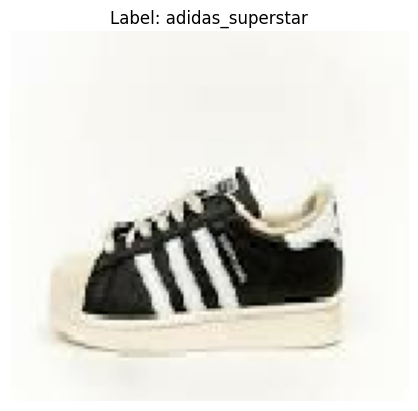

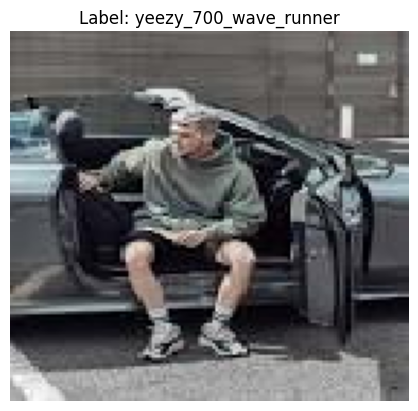

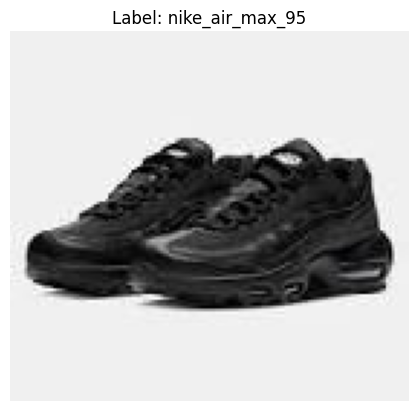

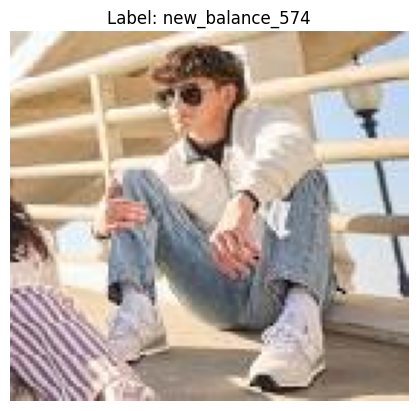

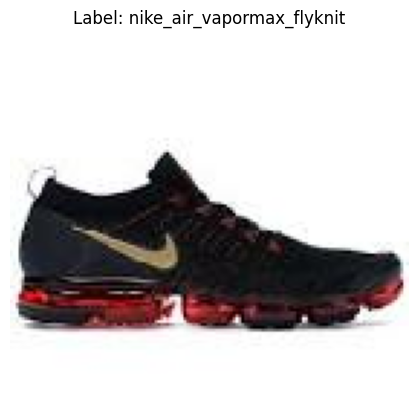

...

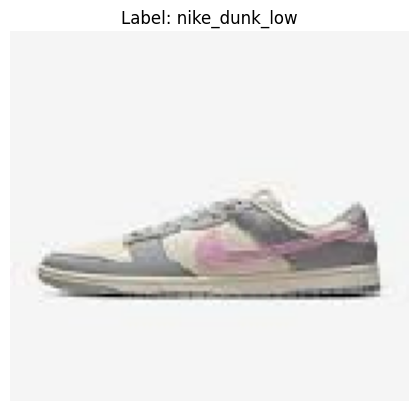

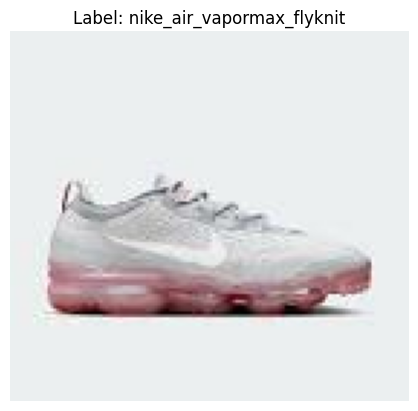

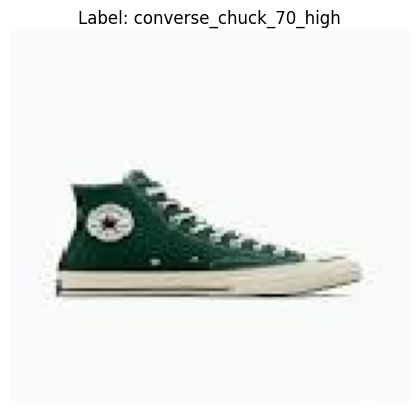

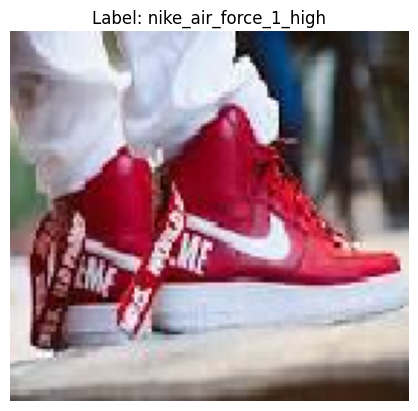

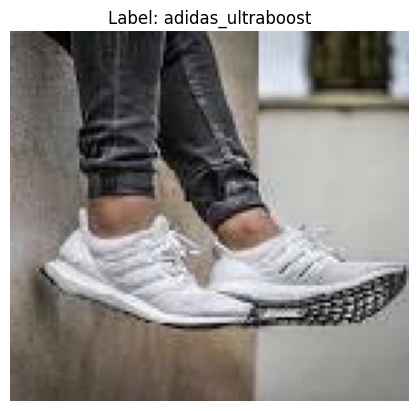

Batch Shape: (32, 128, 138, 3)
Labels Shape: (32,)


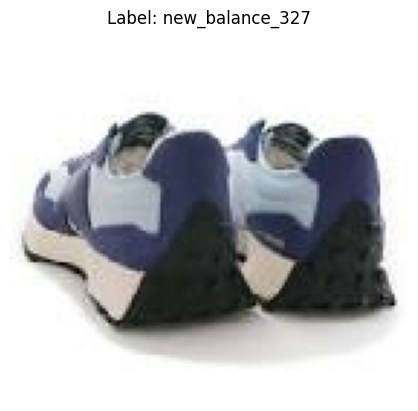

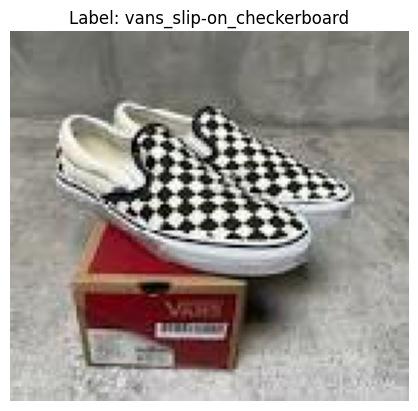

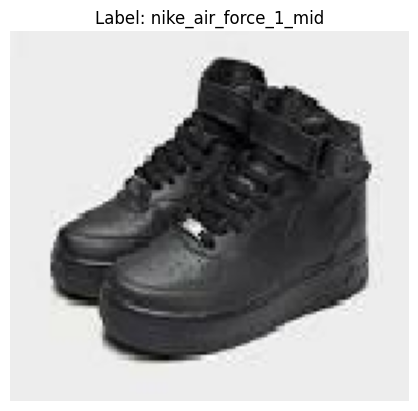

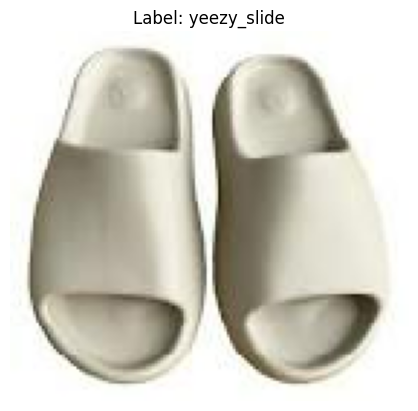

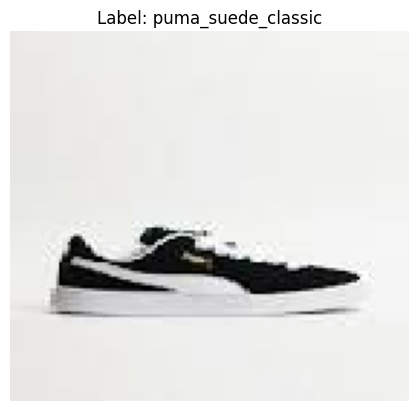

...

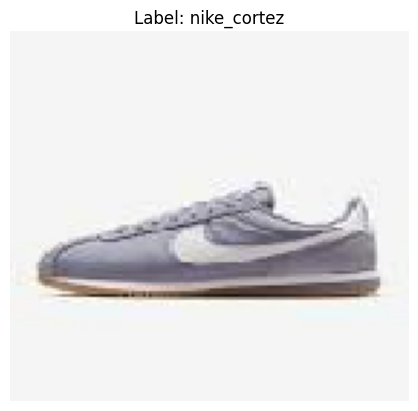

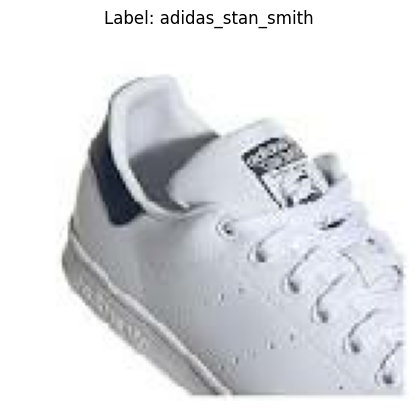

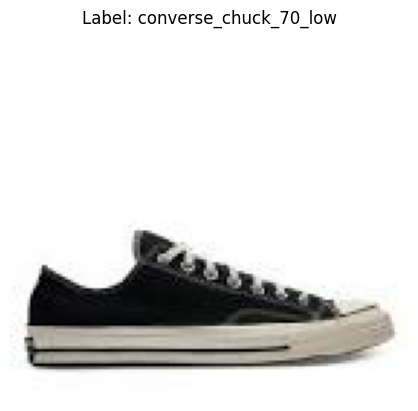

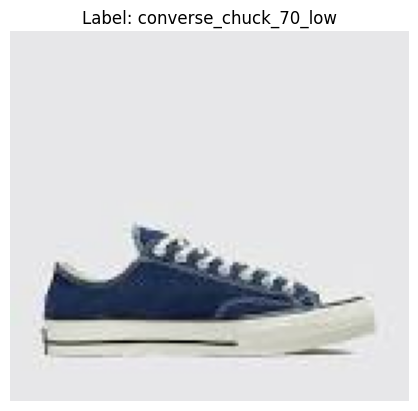

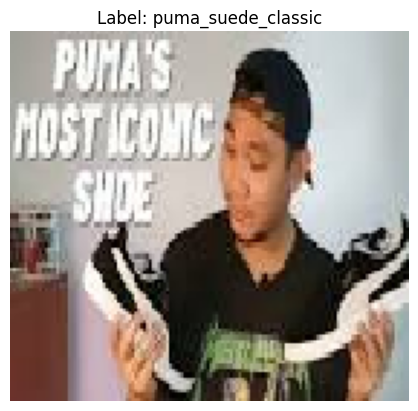

Batch Shape: (32, 128, 138, 3)
Labels Shape: (32,)


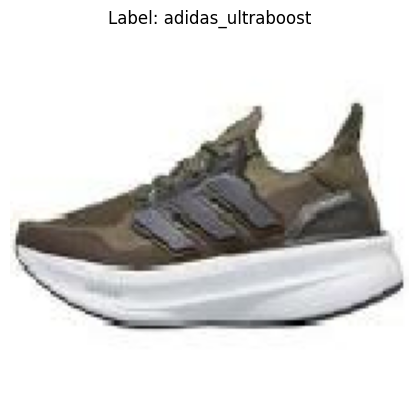

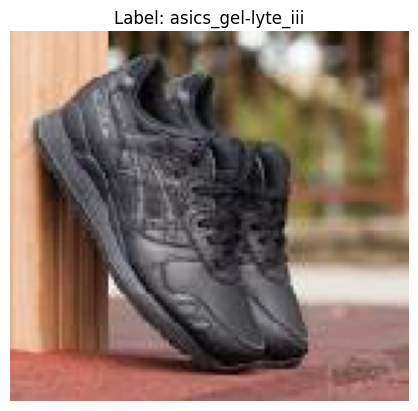

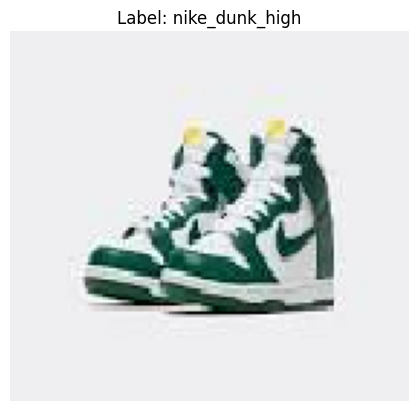

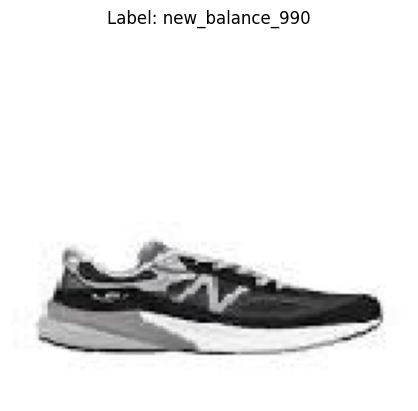

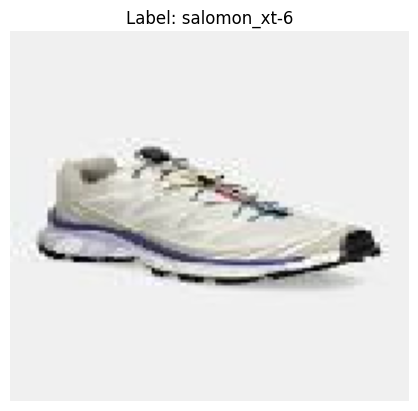

...

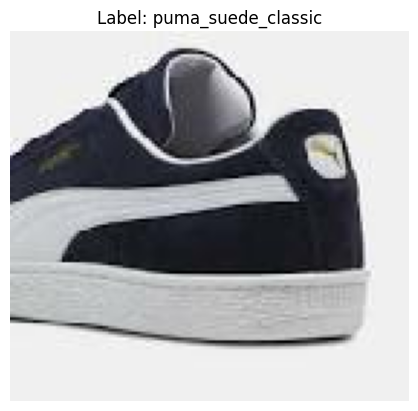

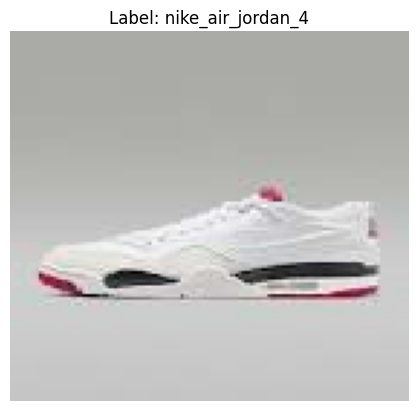

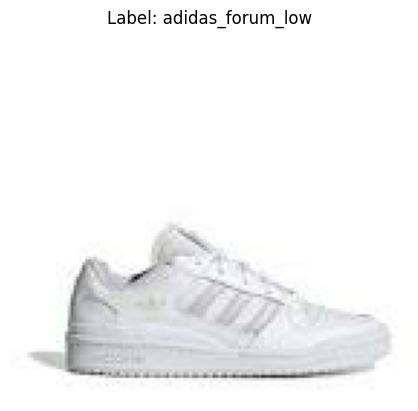

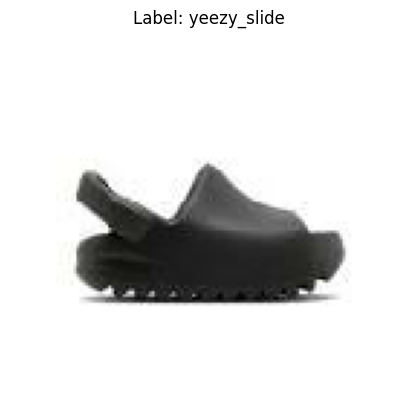

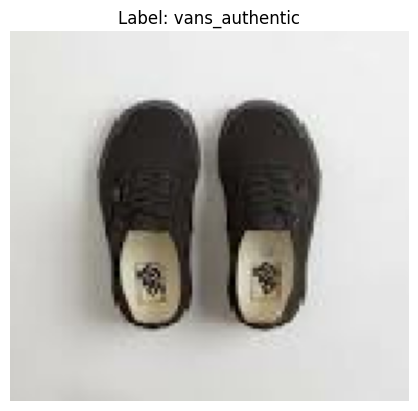

In [30]:
# Get the class names from the dataset
class_names = ds.class_names
print("Discovered class names:", class_names)

# Iterate through a few batches of the dataset
for images, labels in ds.take(3): # take(3) will iterate through the first 3 batches
  print("Batch Shape:", images.shape)
  print("Labels Shape:", labels.shape)

  # Iterate through the images and labels in the current batch
  for i in range(images.shape[0]): # images.shape[0] is the batch size
    plt.figure()
    plt.imshow(images[i].numpy().astype("uint8")) # Display the image
    # Get the class name for the corresponding label
    plt.title(f"Label: {class_names[labels[i].numpy()]}")
    plt.axis("off")
    plt.show()

In [73]:
discovered_class_names = ds.class_names

print("Integer labels map to these class names:")
for i, name in enumerate(discovered_class_names):
    print(f"Label {i}: {name}")

# Compare this with the class_names from your DataFrame
print("\nClass names from DataFrame:")
print(discovered_class_names)

Integer labels map to these class names:
Label 0: adidas_forum_high
Label 1: adidas_forum_low
Label 2: adidas_gazelle
Label 3: adidas_nmd_r1
Label 4: adidas_samba
Label 5: adidas_stan_smith
Label 6: adidas_superstar
Label 7: adidas_ultraboost
Label 8: asics_gel-lyte_iii
Label 9: converse_chuck_70_high
Label 10: converse_chuck_70_low
Label 11: converse_chuck_taylor_all-star_high
Label 12: converse_chuck_taylor_all-star_low
Label 13: converse_one_star
Label 14: new_balance_327
Label 15: new_balance_550
Label 16: new_balance_574
Label 17: new_balance_990
Label 18: new_balance_992
Label 19: nike_air_force_1_high
Label 20: nike_air_force_1_low
Label 21: nike_air_force_1_mid
Label 22: nike_air_jordan_11
Label 23: nike_air_jordan_1_high
Label 24: nike_air_jordan_1_low
Label 25: nike_air_jordan_3
Label 26: nike_air_jordan_4
Label 27: nike_air_max_1
Label 28: nike_air_max_270
Label 29: nike_air_max_90
Label 30: nike_air_max_95
Label 31: nike_air_max_97
Label 32: nike_air_max_plus_(tn)
Label 33:

In [46]:
class_names = df['class'].unique()

In [31]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential

In [32]:
base_model = ResNet50(weights='imagenet', include_top=False)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [33]:
model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(len(class_names), activation='softmax')
])

In [34]:
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, None, None,     │    23,587,712 │
│                                 │ 2048)                  │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 50)             │       102,450 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,690,162 (90.37 MB)

 Trainable params: 23,637,042 (90.17 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [35]:
dataset_size = tf.data.experimental.cardinality(ds).numpy() * 32 # Assuming batch size 32
train_size = int(0.8 * dataset_size)
test_size = dataset_size - train_size

In [36]:
print(dataset_size)
print(train_size)
print(test_size)

5984
4787
1197


In [38]:
ds_shuffled = ds.shuffle(buffer_size=1000) # Choose a buffer size appropriate for your memory

train_ds = ds_shuffled.take(int(train_size // 32)) # Take batches for training
test_ds = ds_shuffled.skip(int(train_size // 32))

In [39]:
history = model.fit(train_ds, epochs=9, validation_data=test_ds)

Epoch 1/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 122s 348ms/step - accuracy: 0.0897 - loss: 3.8919 - val_accuracy: 0.0920 - val_loss: 5.1651
Epoch 2/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 31s 173ms/step - accuracy: 0.3562 - loss: 2.3378 - val_accuracy: 0.1965 - val_loss: 3.3706
Epoch 3/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 41s 171ms/step - accuracy: 0.5455 - loss: 1.6360 - val_accuracy: 0.0903 - val_loss: 12.6608
Epoch 4/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 31s 176ms/step - accuracy: 0.6781 - loss: 1.1410 - val_accuracy: 0.3249 - val_loss: 3.3978
Epoch 5/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 30s 171ms/step - accuracy: 0.7410 - loss: 0.8647 - val_accuracy: 0.5370 - val_loss: 1.9056
Epoch 6/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 35s 197ms/step - accuracy: 0.8196 - loss: 0.6157 - val_accuracy: 0.6217 - val_loss: 1.7506
Epoch 7/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 36s 171ms/step - accuracy: 0.8800 - loss: 0.4165 - val_accuracy: 0.5773 - val_loss: 1.6774
Epoch 8/9
149/149 ━━━━━━━━━━━━━━━━━━━━ 35s 198ms/step - accuracy: 0.9162 - loss: 0.3015 

In [42]:
test_loss , test_acc = model.evaluate(test_ds)
print('Test Accuracy: ', test_acc)

38/38 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - accuracy: 0.7576 - loss: 0.8933
Test Accuracy:  0.7557565569877625


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


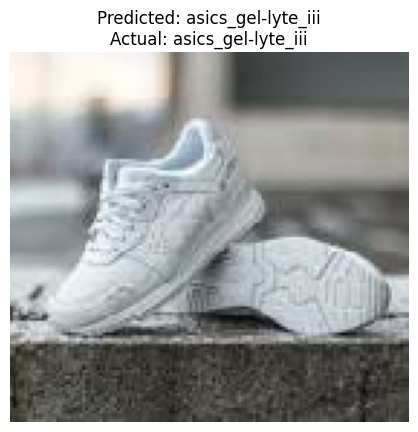

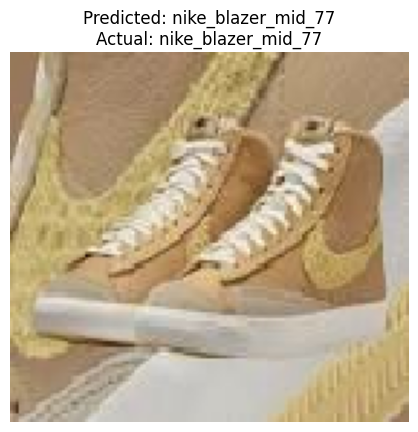

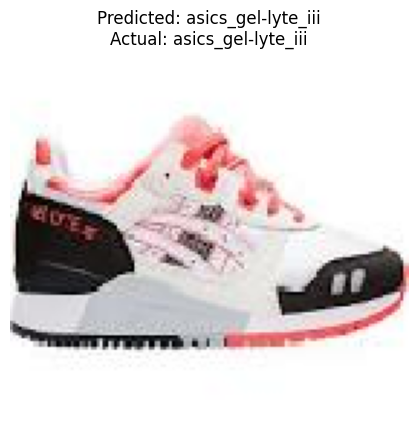

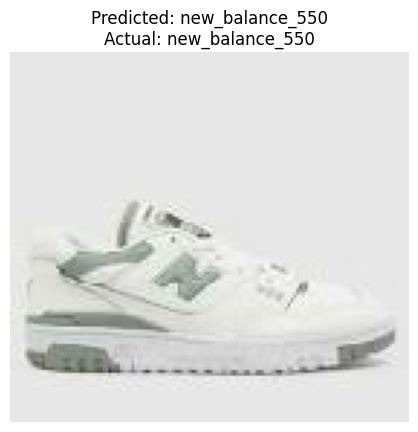

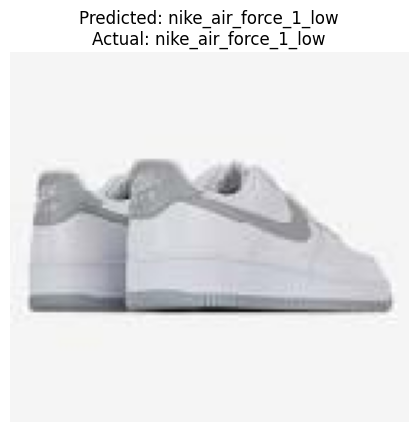

...

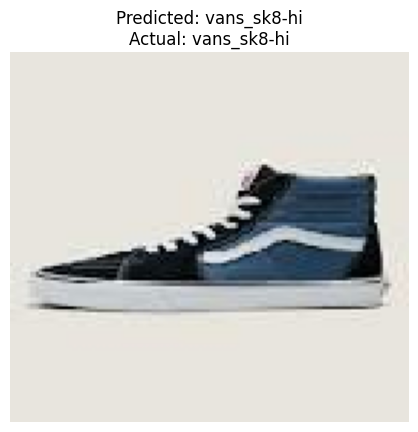

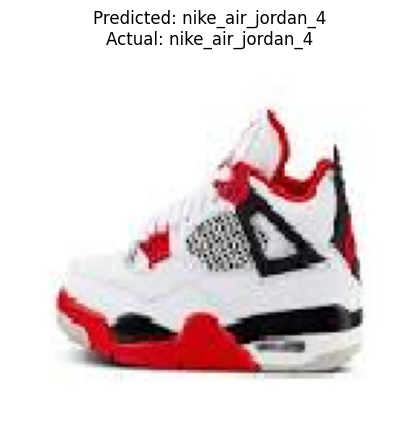

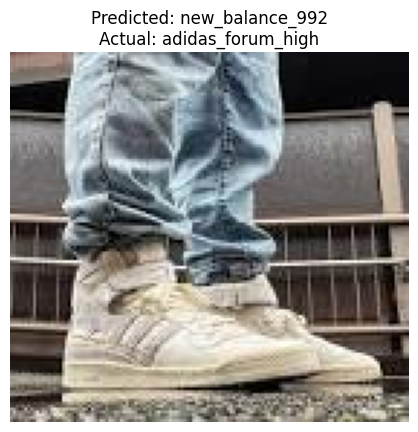

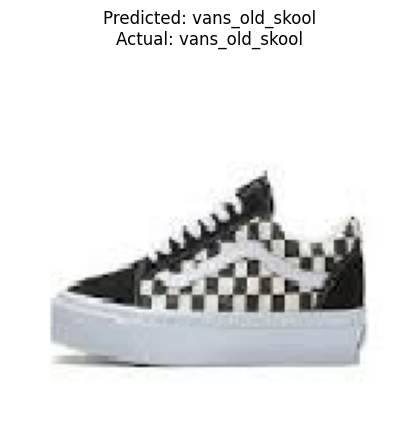

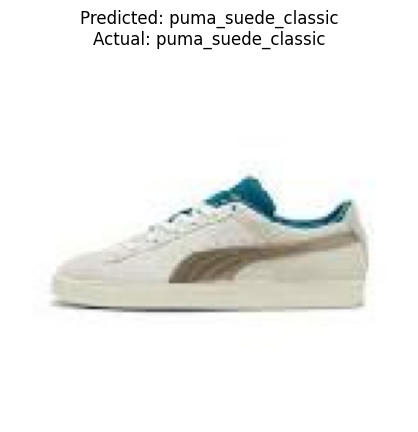

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


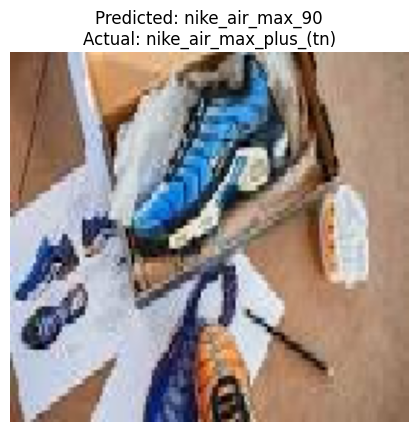

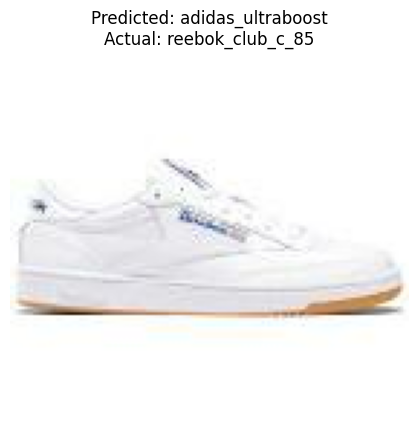

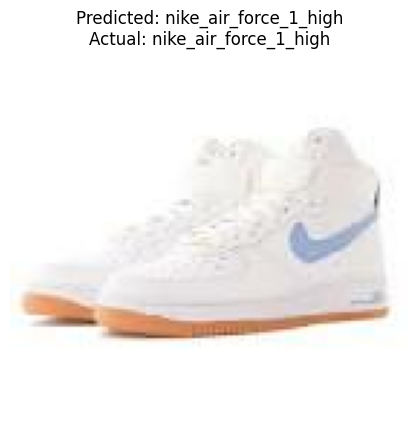

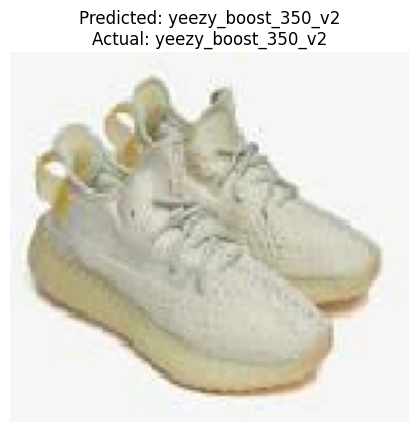

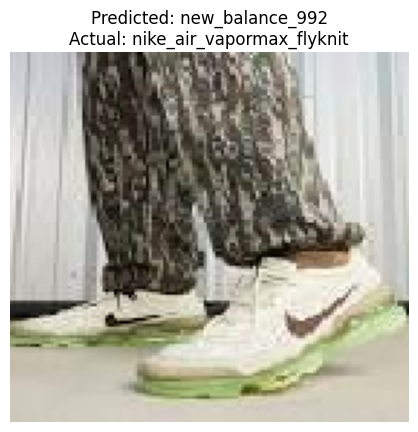

...

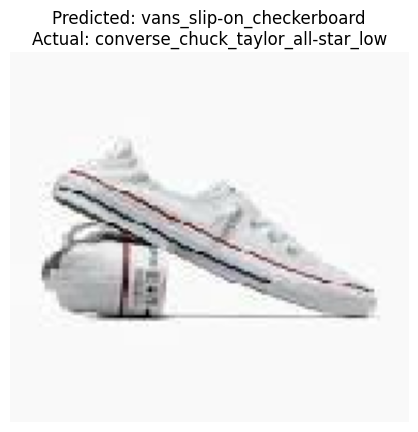

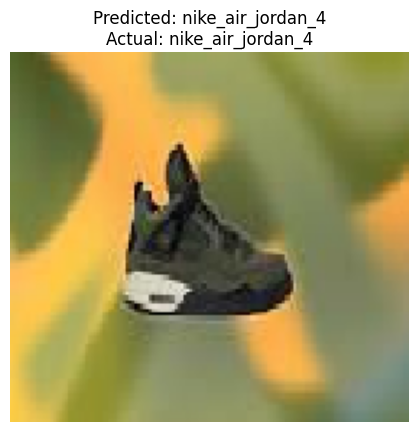

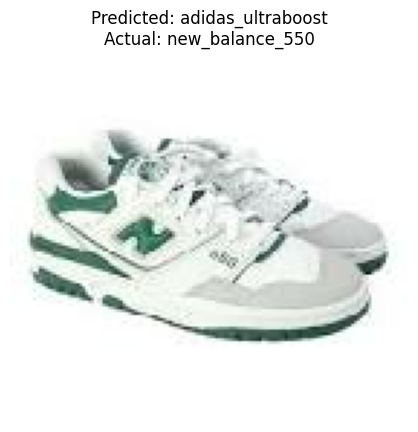

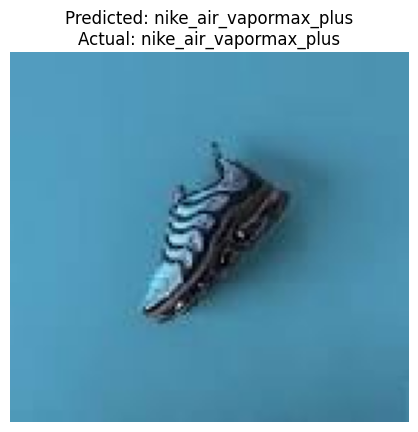

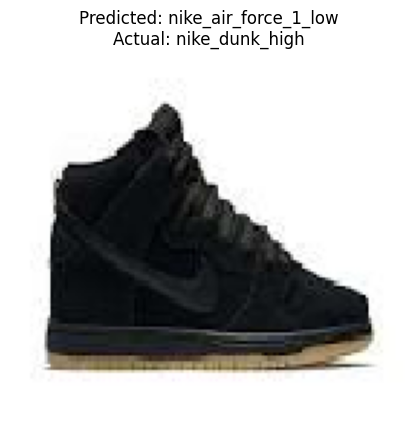

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


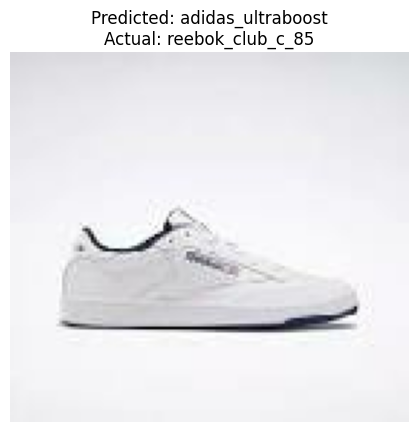

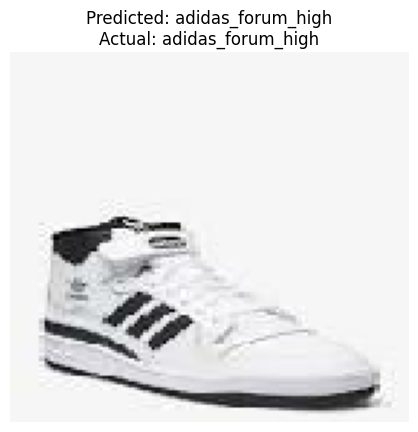

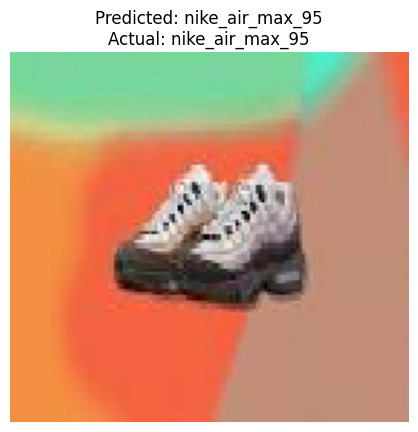

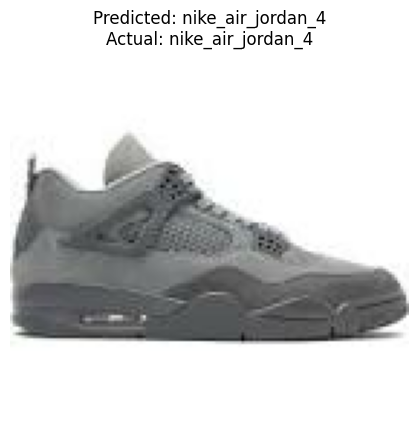

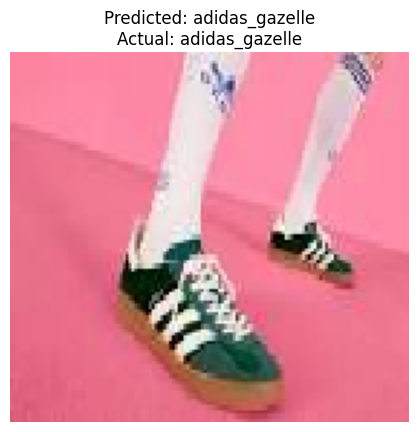

...

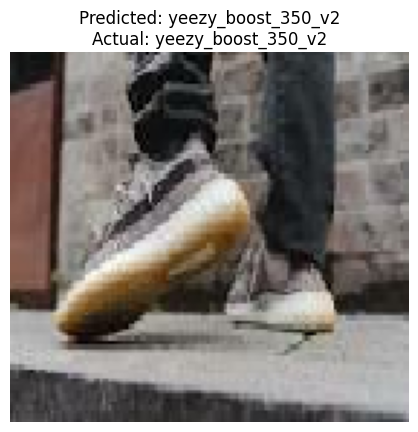

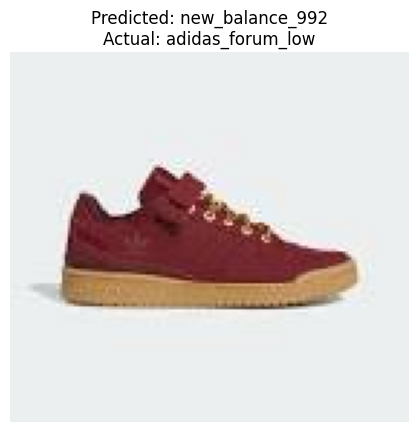

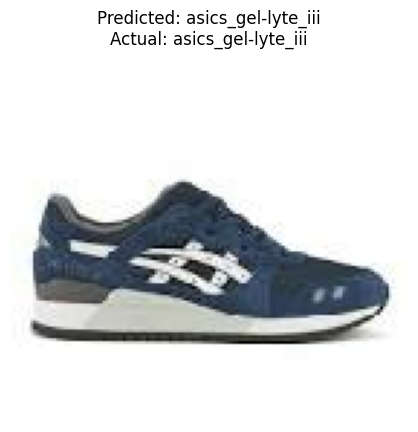

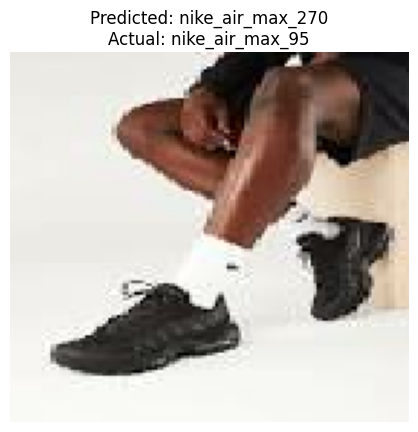

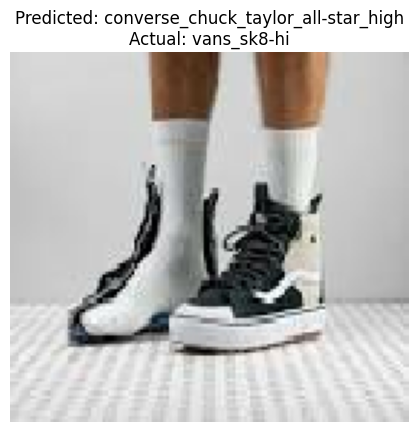

In [48]:
for images, labels in test_ds.take(3):
  batch_predictions = model.predict(images)

  for i in range(images.shape[0]):
    plt.figure()
    plt.imshow(images[i].numpy().astype("uint8"))

    predicted_class_index = np.argmax(batch_predictions[i])
    predicted_class_name = class_names[predicted_class_index]

    actual_class_index = labels[i].numpy()
    actual_class_name = class_names[actual_class_index]

    plt.title(f"Predicted: {predicted_class_name}\nActual: {actual_class_name}")
    plt.axis("off")
    plt.show()